In [4]:
using DataFrames, GraphPlot, Impute, Plots, Colors

dir = "../Mariana-Paquete/Mariana-Basefunc/"

include(dir*"funciones_de_red.jl")
include(dir*"objetos.jl")
include(dir*"dinamica_conductores.jl")
include(dir*"animaciones.jl")

plot_digraph (generic function with 1 method)

# Sin diagonales

In [5]:
k = 5
m = k^2
SquareNet, position_array, dist_matrix = SquareDiGraph(k, doble_sentido=true);

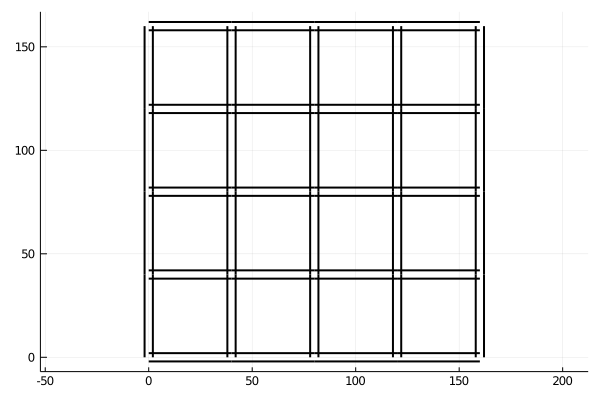

In [6]:
plot_digraph(SquareNet, position_array, separated_edges=true)

In [7]:
city_matrix = zeros(m,m,4);
f = x -> [speed(i,j,x) for i in 1:length(x),j in 1:length(x)]
city_matrix[:,:,1] = dist_matrix./f(position_array);
city_matrix[:,:,2] = dist_matrix.*3/5;
city_matrix[:,:,4] = BPR.(city_matrix[:,:,1], city_matrix[:,:,3],city_matrix[:,:,2]);
red_cuadrada=network(SquareNet,position_array,city_matrix);

In [8]:
function generate_auto(m,t,red)
    o = rand(1:m)
    d = collect(1:m)
    splice!(d,o)
    d = d[rand(1:end)]
    return auto(o,d,t,0.25,red)
end

autos = [generate_auto(m,t,red_cuadrada) for t in collect(0.5:0.321:150.)];

In [9]:
times, vels = simulacion!(0.,red_cuadrada, autos);

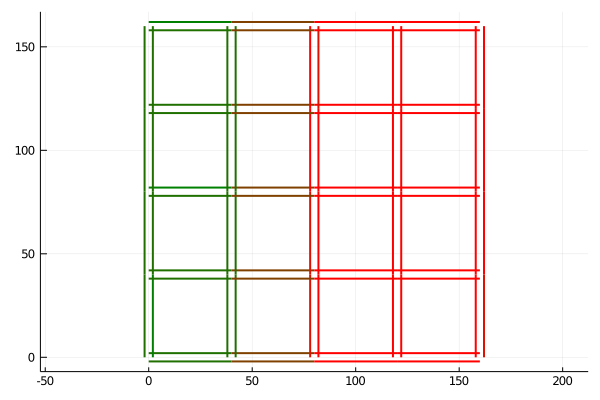

In [10]:
plot_digraph(SquareNet,position_array, attribute_matrix=vels,separated_edges=true)

In [11]:
new_times, x_out, y_out, x_dest, y_dest = continuos_time!(times,autos);

In [12]:
c1 = colorant"red"
c2 = colorant"blue"
carcolors = range(c1, stop=c2, length=length(autos))

In [17]:
to_follow = rand(1:length(autos),5)

5-element Array{Int64,1}:
 254
 252
  14
 430
  29

┌ Info: Saved animation to 
│   fn = /Users/Mariana/Documents/Code-MarianaTesis/code/julia-code/gifs/firstdaynodiag-big-5followed.gif
└ @ Plots /Users/Mariana/.julia/packages/Plots/XbAWb/src/animation.jl:104


Plots.AnimatedGif("/Users/Mariana/Documents/Code-MarianaTesis/code/julia-code/gifs/firstdaynodiag-big-5followed.gif")
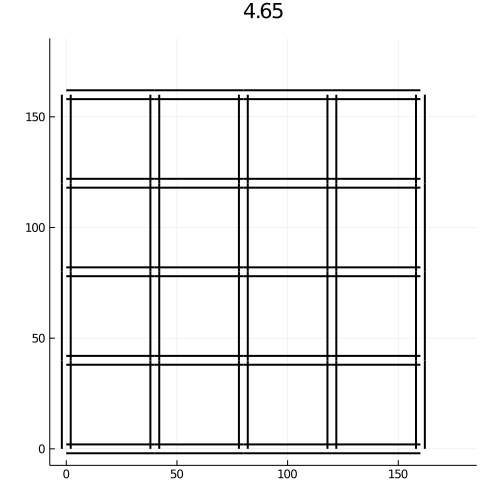

In [18]:
t1 = findall(x -> (x in round.(autos[minimum(to_follow)].ts,digits=2)),new_times)[1]
t2 = findall(x -> (x in round.(autos[maximum(to_follow)].llego,digits=2)),new_times)[end]
anim = @animate for i in t1-2:10:t2+2
    x = [element[i] for element in x_out[to_follow]]
    y = [element[i] for element in y_out[to_follow]]
    x2 = [element[i] for element in x_dest[to_follow]]
    y2 = [element[i] for element in y_dest[to_follow]]
    fig = plot_digraph(SquareNet, position_array,separated_edges=true)

    scatter!(x, y, xlim=[-2,180],ylim=[-2,180], labels=false, title = string(new_times[i]),
        mcolor = carcolors[to_follow], aspect_ratio =1, size=(500,500))
    scatter!(x2, y2, xlim=[-2,180],ylim=[-2,180], labels=false,
        mcolor = RGB(0,1,0), aspect_ratio =1, size=(500,500))
end
gif(anim, "../gifs/firstdaynodiag-big-5followed.gif", fps = 50)

┌ Info: Saved animation to 
│   fn = /Users/Mariana/Documents/Code-MarianaTesis/code/julia-code/gifs/firstdaynodiag-big.gif
└ @ Plots /Users/Mariana/.julia/packages/Plots/XbAWb/src/animation.jl:104


Plots.AnimatedGif("/Users/Mariana/Documents/Code-MarianaTesis/code/julia-code/gifs/firstdaynodiag-big.gif")
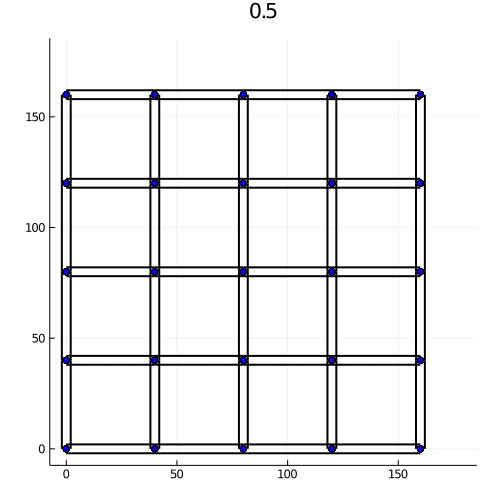

In [19]:
anim = @animate for i in 1:10:length(new_times)
    x = [element[i] for element in x_out]
    y = [element[i] for element in y_out]
    x2 = [element[i] for element in x_dest]
    y2 = [element[i] for element in y_dest]
    fig = plot_digraph(SquareNet, position_array, separated_edges=true)

    scatter!(x, y, xlim=[-2,180],ylim=[-2,180], labels=false, title = string(new_times[i]),
        mcolor = carcolors, aspect_ratio =1, size=(500,500))
    scatter!(x2, y2, xlim=[-2,180],ylim=[-2,180], labels=false,
        mcolor = RGB(0,1,0), aspect_ratio =1, size=(500,500))
end
gif(anim, "../gifs/firstdaynodiag-big.gif", fps = 50)

In [20]:
restart(autos, red_cuadrada);
times, vels = simulacion!(0.,red_cuadrada, autos);
new_times, x_out, y_out, x_dest, y_dest = continuos_time!(times,autos);

┌ Info: Saved animation to 
│   fn = /Users/Mariana/Documents/Code-MarianaTesis/code/julia-code/gifs/seconddaynodiag-big-5followed.gif
└ @ Plots /Users/Mariana/.julia/packages/Plots/XbAWb/src/animation.jl:104


Plots.AnimatedGif("/Users/Mariana/Documents/Code-MarianaTesis/code/julia-code/gifs/seconddaynodiag-big-5followed.gif")
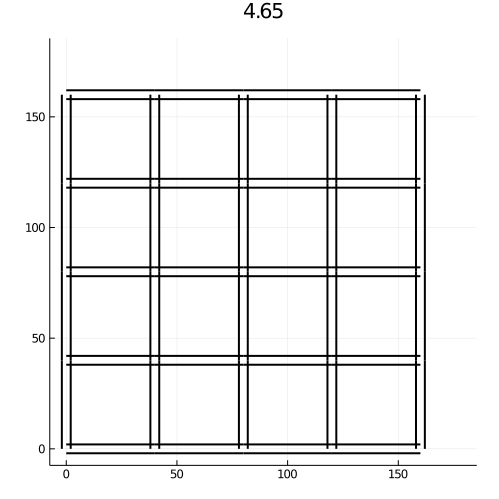

In [21]:
t1 = findall(x -> (x in round.(autos[minimum(to_follow)].ts,digits=2)),new_times)[1]
t2 = findall(x -> (x in round.(autos[maximum(to_follow)].llego,digits=2)),new_times)[end]
anim = @animate for i in t1-2:10:t2+2    
    x = [element[i] for element in x_out[to_follow]]
    y = [element[i] for element in y_out[to_follow]]
    x2 = [element[i] for element in x_dest[to_follow]]
    y2 = [element[i] for element in y_dest[to_follow]]
    fig = plot_digraph(SquareNet, position_array, separated_edges=true)

    scatter!(x, y, xlim=[-2,180],ylim=[-2,180], labels=false, title = string(new_times[i]),
        mcolor = carcolors[to_follow], aspect_ratio =1, size=(500,500))
    scatter!(x2, y2, xlim=[-2,180],ylim=[-2,180], labels=false,
        mcolor = RGB(0,1,0), aspect_ratio =1, size=(500,500))
end
gif(anim, "../gifs/seconddaynodiag-big-5followed.gif", fps = 50)

# Con diagonales

In [22]:
nw,posarr,distm = SquareDiGraph(5, doble_sentido=true)
diag_start = [7.,160.];
pendiente = -pi/5;
nw, posarr, distm, new_positions = add_diagonal!(nw,posarr,diag_start, pendiente, 5.,40.)
SquareNet, position_array, dist_matrix = make_slow_corners(nw,posarr,new_positions);

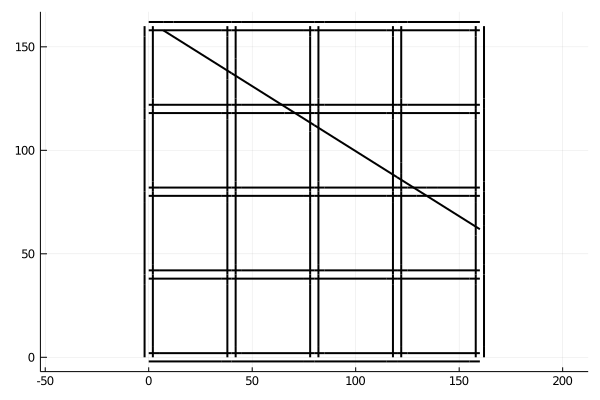

In [23]:
plot_digraph(SquareNet, position_array, separated_edges=true)

In [24]:
j = nv(nw)
city_matrix = zeros(j, j,4);
f = x -> [speed(i,j,x) for i in 1:length(x),j in 1:length(x)]
city_matrix[:,:,1] = dist_matrix./f(position_array);
city_matrix[:,:,2] = max.(dist_matrix.*3/5,ones(j,j).*6);
city_matrix[:,:,4] = BPR.(city_matrix[:,:,1], city_matrix[:,:,3],city_matrix[:,:,2]);
red_cuadrada=network(SquareNet,position_array,city_matrix);

In [25]:
autos = [generate_auto(m,t,red_cuadrada) for t in collect(0.5:0.321:150.)];

In [26]:
times, vels = simulacion!(0.,red_cuadrada, autos);

In [27]:
new_times, x_out, y_out, x_dest, y_dest = continuos_time!(times,autos);

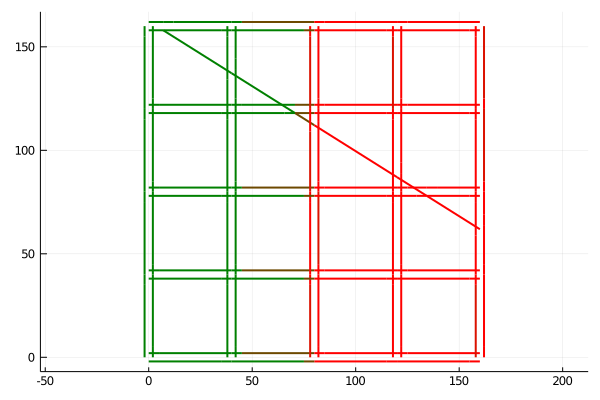

In [28]:
plot_digraph(SquareNet, position_array, attribute_matrix=vels,separated_edges=true)

In [29]:
to_follow = rand(1:length(autos),5)

5-element Array{Int64,1}:
   4
 278
  92
 128
 404

┌ Info: Saved animation to 
│   fn = /Users/Mariana/Documents/Code-MarianaTesis/code/julia-code/gifs/firstdaydiag-big-5followed.gif
└ @ Plots /Users/Mariana/.julia/packages/Plots/XbAWb/src/animation.jl:104


Plots.AnimatedGif("/Users/Mariana/Documents/Code-MarianaTesis/code/julia-code/gifs/firstdaydiag-big-5followed.gif")
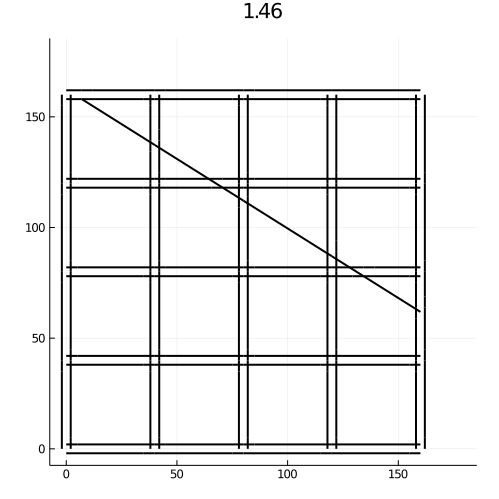

In [30]:
t1 = findall(x -> (x in round.(autos[minimum(to_follow)].ts,digits=2)),new_times)[1]
t2 = findall(x -> (x in round.(autos[maximum(to_follow)].llego,digits=2)),new_times)[1]
anim = @animate for i in t1:10:t2+2        
    x = [element[i] for element in x_out[to_follow]]
    y = [element[i] for element in y_out[to_follow]]
    x2 = [element[i] for element in x_dest[to_follow]]
    y2 = [element[i] for element in y_dest[to_follow]]
    fig = plot_digraph(SquareNet, position_array, separated_edges=true)

    scatter!(x, y, xlim=[-2,180],ylim=[-2,180], labels=false, title = string(new_times[i]),
        mcolor = carcolors[to_follow], aspect_ratio =1, size=(500,500))
    scatter!(x2, y2, xlim=[-2,180],ylim=[-2,180], labels=false,
        mcolor = RGB(0,1,0), aspect_ratio =1, size=(500,500))
end
gif(anim, "../gifs/firstdaydiag-big-5followed.gif", fps = 50)

┌ Info: Saved animation to 
│   fn = /Users/Mariana/Documents/Code-MarianaTesis/code/julia-code/gifs/firstdaydiag-big.gif
└ @ Plots /Users/Mariana/.julia/packages/Plots/XbAWb/src/animation.jl:104


Plots.AnimatedGif("/Users/Mariana/Documents/Code-MarianaTesis/code/julia-code/gifs/firstdaydiag-big.gif")
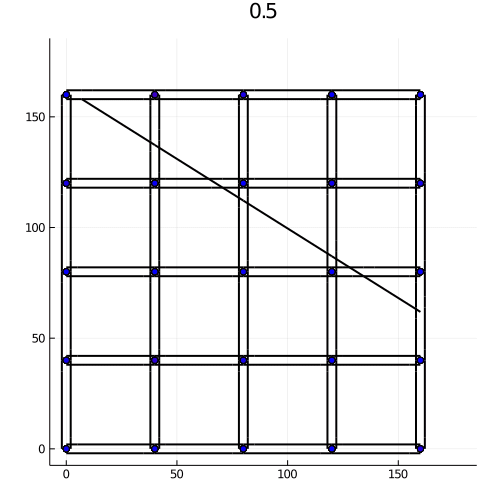

In [31]:
anim = @animate for i in 1:10:length(new_times)
    x = [element[i] for element in x_out]
    y = [element[i] for element in y_out]
    x2 = [element[i] for element in x_dest]
    y2 = [element[i] for element in y_dest]
    fig = plot_digraph(SquareNet, position_array, separated_edges=true)

    scatter!(x, y, xlim=[-2,180],ylim=[-2,180], labels=false, title = string(new_times[i]),
        mcolor = carcolors, aspect_ratio =1, size=(500,500))
    scatter!(x2, y2, xlim=[-2,180],ylim=[-2,180], labels=false,
        mcolor = RGB(0,1,0), aspect_ratio =1, size=(500,500))
end
gif(anim, "../gifs/firstdaydiag-big.gif", fps = 50)

In [32]:
restart(autos, red_cuadrada);
times, vels = simulacion!(0.,red_cuadrada, autos);
new_times, x_out, y_out, x_dest, y_dest = continuos_time!(times,autos);

┌ Info: Saved animation to 
│   fn = /Users/Mariana/Documents/Code-MarianaTesis/code/julia-code/gifs/seconddaydiag-big-5followed.gif
└ @ Plots /Users/Mariana/.julia/packages/Plots/XbAWb/src/animation.jl:104


Plots.AnimatedGif("/Users/Mariana/Documents/Code-MarianaTesis/code/julia-code/gifs/seconddaydiag-big-5followed.gif")
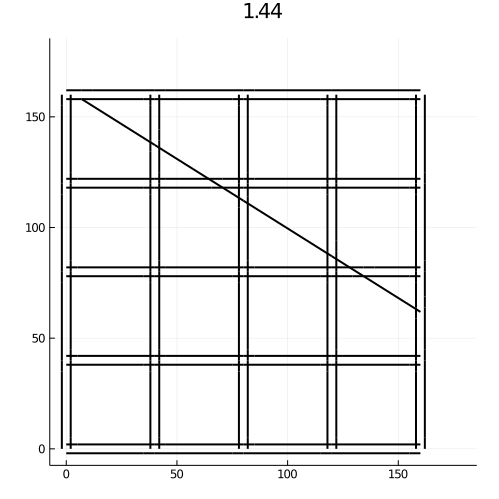

In [33]:
t1 = findall(x -> (x in round.(autos[minimum(to_follow)].ts,digits=2)),new_times)[1]
t2 = findall(x -> (x in round.(autos[maximum(to_follow)].llego,digits=2)),new_times)[end]
anim = @animate for i in t1-2:10:t2+2    
    x = [element[i] for element in x_out[to_follow]]
    y = [element[i] for element in y_out[to_follow]]
    x2 = [element[i] for element in x_dest[to_follow]]
    y2 = [element[i] for element in y_dest[to_follow]]
    fig = plot_digraph(SquareNet, position_array, separated_edges=true)

    scatter!(x, y, xlim=[-2,180],ylim=[-2,180], labels=false, title = string(new_times[i]),
        mcolor = carcolors[to_follow], aspect_ratio =1, size=(500,500))
    scatter!(x2, y2, xlim=[-2,180],ylim=[-2,180], labels=false,
        mcolor = RGB(0,1,0), aspect_ratio =1, size=(500,500))
end
gif(anim, "../gifs/seconddaydiag-big-5followed.gif", fps = 50)

# Para la animación
- Segun la dirección de la arista y los autos moverlos un poco. <input type="checkbox" checked>
- Que los autos aparezcan cuando van a salir. <input type="checkbox" checked>
- Graficar la velocidad promedio en la arista durante la simulación. <input type="checkbox" checked>
- Quitar de la matriz para graficar las aristas que no están realmente <input type="checkbox" checked>
- Corregir el esquema de colores <input type="checkbox" checked>
- Colorear de verde a los que ya llegaron a su destino <input type="checkbox" checked>
- Refinar los tiempos para que todos alcancen a llegar <input type="checkbox" checked>


# Para simulación
- Pruebas de tiempo de la simulación para distintos tamaños de red y distinto número de autos (elapse).
    - Primero mantener constante el numero de autos y crecer la red hasta 100x100 <input type="checkbox" checked>
    - Con la red de 100x100 empezar a aumentar el número de autos <input type="checkbox" checked>
- 100x100 es razonable, ¿Cómo crece el tiempo conforme hay más autos? hasta ~200 más o menos. <input type="checkbox">
- Calles alternadas y 1 carril, quizás la longitud de la calle tenga que reuducirse también. <input type="checkbox">
- Simulación de 100x100 con 80k autos aprox. <input type="checkbox">

__________________________________________________________________________

# Mediciones
- Velocidad promedio respecto al número de días, probarlo con estas pequeñas. <input type="checkbox">
- Experimentar con diferentes combinaciones de diagonales (dobles sentidos, paralelas, con y sin altos)
- Medir los cambios de ruta, elegir algunas rutas y medir si cambia la distancia (comparar si el camino A* es igual antes y después de que pasó el día) cada día que porcentaje de conductores cambia. <input type="checkbox">
- Entre los que cambian cómo saber si regresan al mismo camino. A partir de cierto número de camino. Graficar para cada auto cuál es su periodo. <input type="checkbox">
- Cómo cambia esto respecto a la distribución de $h$ <input type="checkbox">
- Cómo cambia respecto a la densidad

# Recomendación
- instalar StatsBase